**Colab 5**
We'll dip our toes into the world of GANs, first with a low dimensional toy example, and then with some real images. 

A GAN is most often portrayed as the competition between two networks: one which generates data -- aka the *generator* -- and one which tries to discern whether a given datum is real or fake -- aka the *discriminator*.  The discriminator is fed a steady stream of real data intermixed with the generator's fake data, always scoring what it sees and then getting the answer so it can make a better decision the next time.  The generator is incentivized to make the discriminator as wrong as possible, so it (ideally) keeps trying to refine and improve what it generates.

This competition picture can gloss over an important point, however -- which is that the gradients to the generator flow through the discriminator first, meaning the discriminator acts more like a teacher than a rival.  At every update it lets the generator know what exactly about its creation tipped the discriminator off to it being a fake.  One of the cool ways I've seen it phrased is that you're learning a loss function with the discriminator.

They are much much more finnicky to train, so don't worry if the quality of these results is far off from https://thispersondoesnotexist.com/. We're just shooting for some intuition.

In [78]:
import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline
import tensorflow_datasets as tfds
import numpy as np
import time
import tensorflow_probability as tfp 

tfkl = tf.keras.layers
tfd = tfp.distributions

The car example below takes around a full day to train, so you probably just want to look at the output and the code, and consider training on a smaller problem.  To give something much quicker to run, we'll start with a 1D example.

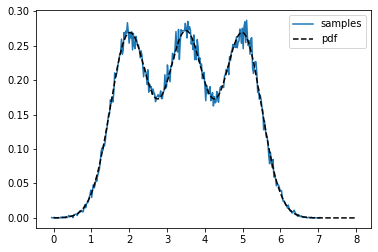

In [201]:
# Use tensorflow_probability to make a mixture of Gaussians
num_gaussians = 3
mus = np.linspace(2, 5, num_gaussians)
sigmas = [0.5]*num_gaussians

dist = tfd.MixtureSameFamily(
  mixture_distribution=tfd.Categorical(logits=np.zeros(num_gaussians)),
  components_distribution=tfd.Normal(
          loc=mus,
          scale=sigmas))
N = 10**5
samples = dist.sample(N)
hist, bins = np.histogram(samples, bins=int(np.sqrt(N)), density=True)

plt.plot((bins[1:]+bins[:-1])/2., hist, label='samples')
xxx = np.linspace(0, 8, 10_000)
plt.plot(xxx, dist.prob(xxx), 'k--', label='pdf')
plt.legend()
plt.show()

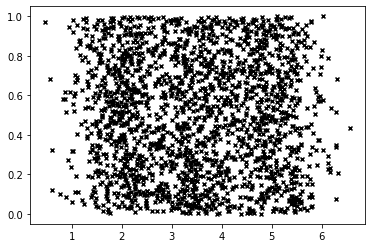

In [202]:
# GANs train on __samples__ from some unknown distribution, and the generator's 
# goal is to generate samples from a mimicked distribution.  Here's all our GAN
# will train on:
N = 2048
plt.scatter(dist.sample(N), np.random.uniform(size=N), s=16, c='k', marker='x')
plt.show()
# For every sample (here, a single scalar; the y axis is just for visualization), the discriminator will assign it a
# score -- higher if it thinks it came from the real distribution and lower it 
# it thinks it came from a fake one

In [205]:
# Leaky relus allow more gradient info to pass back through the discriminator 
# because there is no dead region like in relus (which are leaky relus with alpha = 0)
leaky_alpha = 0.2
disc = tf.keras.Sequential([
                            tfkl.Input((1,)),
                            tfkl.Dense(64),
                            tfkl.LeakyReLU(leaky_alpha),
                            tfkl.Dense(64),
                            tfkl.LeakyReLU(leaky_alpha),
                            tfkl.Dense(1)
])
zdim = 4
kernel_std = bias_std = 0.2
kernel_initializer = tf.keras.initializers.RandomNormal(stddev=kernel_std)
bias_initializer = tf.keras.initializers.RandomNormal(stddev=bias_std)
gen = tf.keras.Sequential([
                            tfkl.Input((zdim,)),
                            tfkl.Dense(128, 'tanh', kernel_initializer=kernel_initializer, bias_initializer=bias_initializer),
                            tfkl.Dense(128, 'tanh', kernel_initializer=kernel_initializer, bias_initializer=bias_initializer),
                            tfkl.Dense(128, 'tanh', kernel_initializer=kernel_initializer, bias_initializer=bias_initializer),
                            tfkl.Dense(1, kernel_initializer=tf.keras.initializers.RandomUniform(-1, 1)),
])

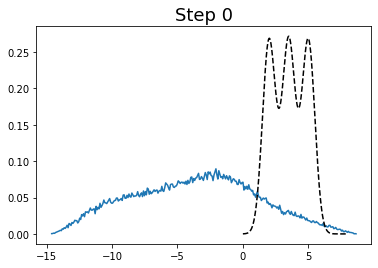

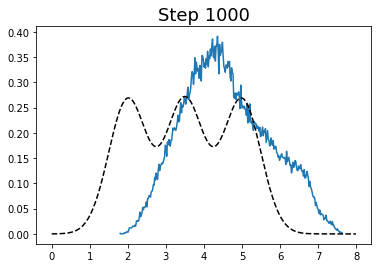

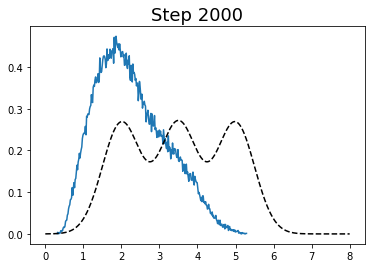

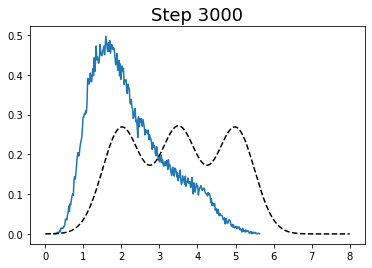

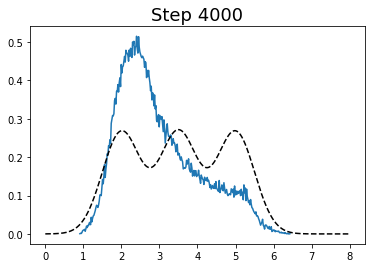

...

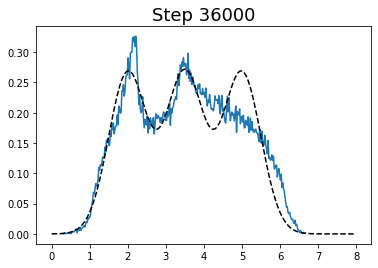

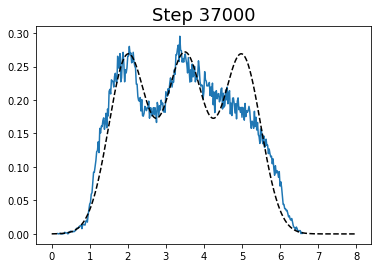

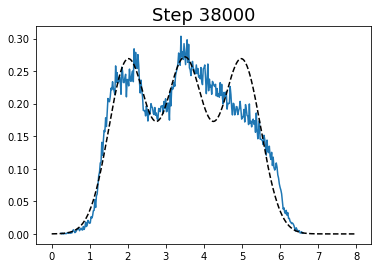

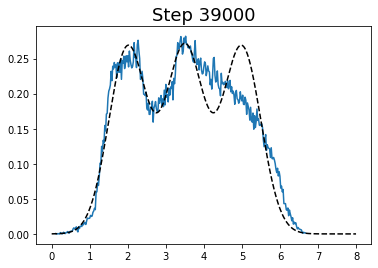

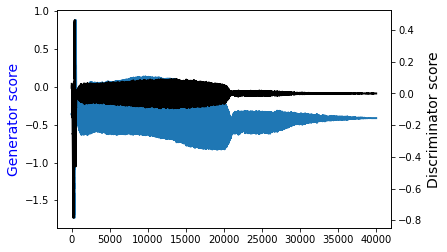

In [206]:
bs = 1024
num_steps = 40_000
disc_learning_speedup_factor = 3
learning_rate = 5e-5
def cosine_decay(step, warmup_steps=1000):
  ### TODO: Write a learning rate schedule ramps up to <learning_rate> linearly
  # from zero over the first <warmup_steps>, then decays as a half period of a 
  # cosine over the rest of training (from <warmup_steps> until <num_steps>)
  return scheduled_learning_rate

# We use a different optimizer for the generator and discriminator
# RMSprop is an adaptive optimizer like Adam, but it can be far better for GANs
opt_gen = tf.keras.optimizers.RMSprop()
opt_disc = tf.keras.optimizers.RMSprop()

@tf.function
def training_step(real_vals):
  real_vals = tf.cast(real_vals, tf.float32)[:, tf.newaxis]
  z_vec = tf.random.uniform((bs, zdim), minval=-1., maxval=1., dtype=tf.float32)
  with tf.GradientTape(persistent=True) as tape:
    fake_vals = gen(z_vec, training=True)
    fake_scores = disc(fake_vals, training=True)
    real_scores = disc(real_vals, training=True)
    loss_generator = -tf.reduce_mean(fake_scores)
    loss_discriminator = tf.reduce_mean(fake_scores) - tf.reduce_mean(real_scores)

  grads_gen = tape.gradient(loss_generator, gen.trainable_variables)
  grads_disc = tape.gradient(loss_discriminator, disc.trainable_variables)
  del tape
  opt_gen.apply_gradients(zip(grads_gen, gen.trainable_variables))
  opt_disc.apply_gradients(zip(grads_disc, disc.trainable_variables))
  return loss_generator, loss_discriminator

scores_gen, scores_disc = [[], []]

for step in range(num_steps):
  changing_learning_rate = cosine_decay(step)
  tf.keras.backend.set_value(opt_gen.learning_rate,
                               changing_learning_rate)
  tf.keras.backend.set_value(opt_disc.learning_rate,
                               changing_learning_rate*disc_learning_speedup_factor)
  real_vals = dist.sample(bs)
  score_gen, score_disc = training_step(real_vals)

  scores_gen.append(score_gen.numpy())
  scores_disc.append(score_disc.numpy())
  if step % 1000 == 0:
    N = 10**5
    z_vec = tf.random.uniform((N, zdim), minval=-1., maxval=1., dtype=tf.float32)
    fake_vals = gen(z_vec, training=False)
    hist, bins = np.histogram(fake_vals, bins=int(np.sqrt(N)), density=True)
    plt.figure(figsize=(6, 4))
    plt.plot((bins[1:]+bins[:-1])/2., hist)
    xxx = np.linspace(0, 8, 10_000)
    plt.plot(xxx, dist.prob(xxx), 'k--')
    plt.title(f'Step {step}', fontsize=18)
    plt.show()
  if (step+1) % 5_000 == 0:
    plt.figure(figsize=(6, 4))
    plt.plot(scores_gen, lw=2, label='Generator')
    ax = plt.gca()
    ax2 = ax.twinx()
    ax2.plot(scores_disc, 'k', lw=2, label='Discriminator')
    plt.xlabel('Step', fontsize=14)
    ax.set_ylabel('Generator score', color='b', fontsize=14)
    ax2.set_ylabel('Discriminator score', fontsize=14)
    plt.show()
  

Training GANs is sensitive to many design choices.  Try the following ablative studies:
- Change the optimizer
- Change the discriminator's learning rate speedup
- Remove the learning rate schedule
- Change the complexity of the disc/gen

# GANERAL MOTERS
Ok now we'll train a GAN on images of cars, which are a little easier than other real image datasets because cars share many (complex) commonalities (e.g. structure/arrangement of wheels, windshield, doors, etc).  This takes freakin forever so I'd just look over the outputs and watch cars start to emerge from pixel goop; if you like, you can run this on your own machine by connecting to a local runtime and leaving it running over a weekend

In [9]:
dsets_combined = tfds.load('cars196')  ## A car dataset w ~15k images

In [50]:
dset = tf.data.experimental.sample_from_datasets((dsets_combined['train'], dsets_combined['test']))

# This is one of the limitations of traditional GANs -- the larger the image size, the harder it is to train
# You can drop this to [48, 48] and train something faster if you'd like
image_size = [96, 96]

# To get the most out of the smallish dataset, we'll augment with a couple basic operations
pepper_noise_std = 0.01
@tf.function
def _preprocess_cars(example):
  image = tf.image.convert_image_dtype(example['image'], tf.float32)
  bbox = example['bbox']
  cropped = tf.image.crop_and_resize(image[tf.newaxis], [bbox], [0], image_size)[0]
  cropped = tf.image.random_flip_left_right(cropped)
  cropped = tf.image.random_contrast(cropped, 0.7, 1.2)
  cropped += tf.random.normal(tuple(image_size+[3]), stddev=pepper_noise_std)
  cropped = tf.clip_by_value(cropped, 0., 1.)
  return cropped

dset = dset.map(_preprocess_cars, num_parallel_calls=tf.data.experimental.AUTOTUNE)

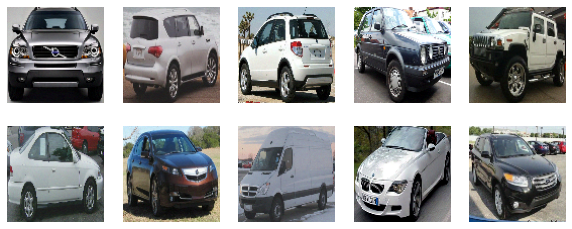

In [51]:
# Plot some example real images
plt.figure(figsize=(10, 4))
for plot_ind, image in enumerate(dset.take(10)):
  plt.subplot(2, 5, plot_ind+1)
  plt.axis('off')
  plt.imshow(image)
plt.show()

In [52]:
# A generator with a nice modular structure
# There are all sorts of (often changing) heuristics out there for GANs; one is to use batch normalization in the generator but not the discriminator
leaky_alpha = 0.05
inp_gen = tfkl.Input((zdim,))
x = tfkl.Dense(36*1024, 'relu')(inp_gen)
x = tfkl.Reshape([6, 6, 1024])(x)

x = tfkl.Conv2DTranspose(512, 4, strides=2, padding='same')(x)
x = tfkl.BatchNormalization(momentum=0.9, scale=True, epsilon=1e-5)(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2DTranspose(512, 4, strides=2, padding='same')(x)
x = tfkl.BatchNormalization(momentum=0.9, scale=True, epsilon=1e-5)(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2DTranspose(256, 4, strides=2, padding='same')(x)
x = tfkl.BatchNormalization(momentum=0.9, scale=True, epsilon=1e-5)(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2DTranspose(128, 4, strides=2, padding='same')(x)
x = tfkl.BatchNormalization(momentum=0.9, scale=True, epsilon=1e-5)(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2D(3, 3, strides=1, activation='sigmoid', padding='same')(x)
generator = tf.keras.Model(inp_gen, x)
print(generator.summary())

In [53]:
# As before, use leaky relus in the discriminator to pass more gradient info along to the generator
leaky_alpha = 0.2
inp_disc = tfkl.Input((96, 96, 3))
x = tfkl.Conv2D(64, 3, strides=1, padding='same')(inp_disc)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2D(64, 4, strides=2, padding='same')(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2D(128, 3, strides=1, padding='same')(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2D(128, 4, strides=2, padding='same')(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2D(256, 3, strides=1, padding='same')(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2D(256, 4, strides=2, padding='same')(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2D(256, 3, strides=1, padding='same')(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2D(256, 4, strides=2, padding='same')(x)
x = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

x = tfkl.Conv2D(512, 3, strides=1, padding='same')(x)
feature_vec = tfkl.LeakyReLU(alpha=leaky_alpha)(x)

logit = tfkl.Dense(1)(tfkl.Flatten()(feature_vec))
discriminator = tf.keras.Model(inp_disc, [logit, tf.nn.sigmoid(logit)])
# print(discriminator.summary())

In [ ]:
# Visualize the output at geometrically spaced intervals
num_viz_dumps = 100
plot_steps = np.unique(np.int32(np.round(np.logspace(-1, np.log(num_steps)/np.log(10), num_viz_dumps))))

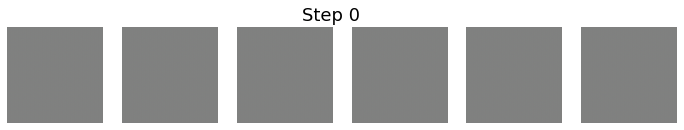

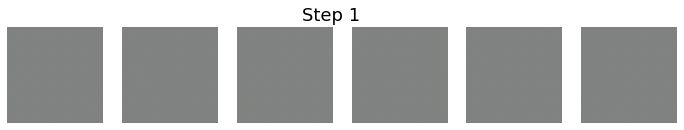

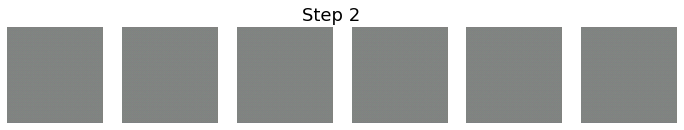

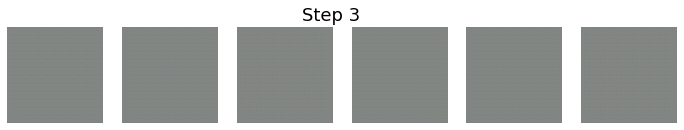

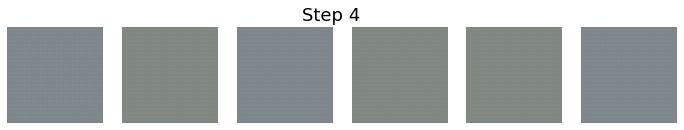

...

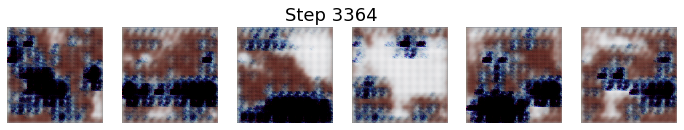

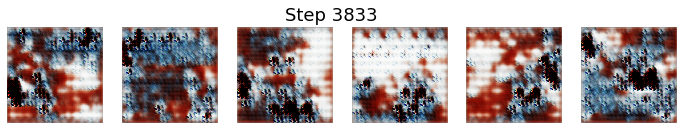

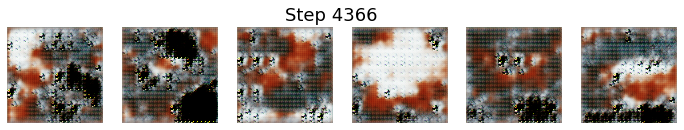

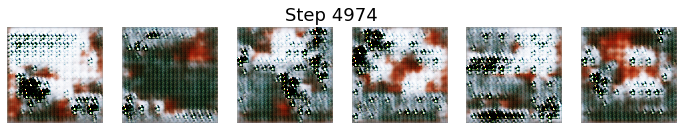

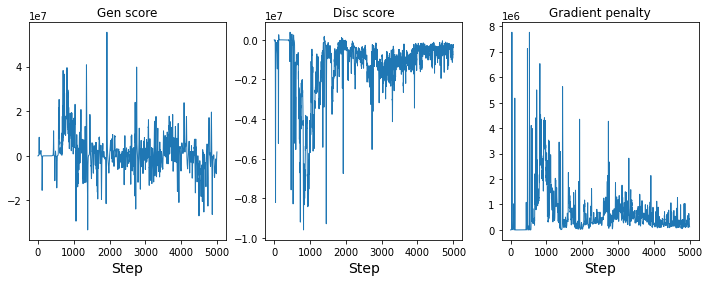

Time taken: 2826.6sec


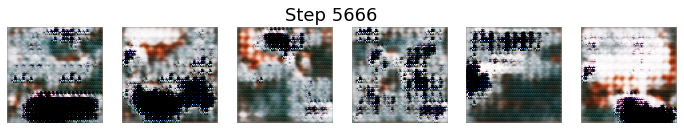

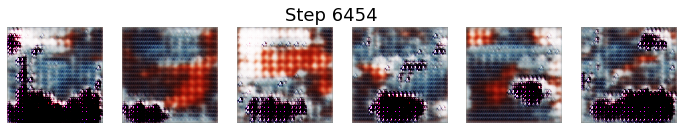

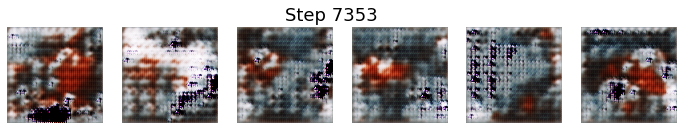

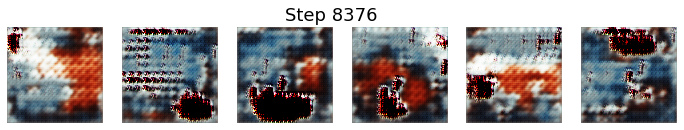

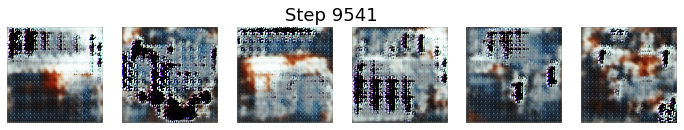

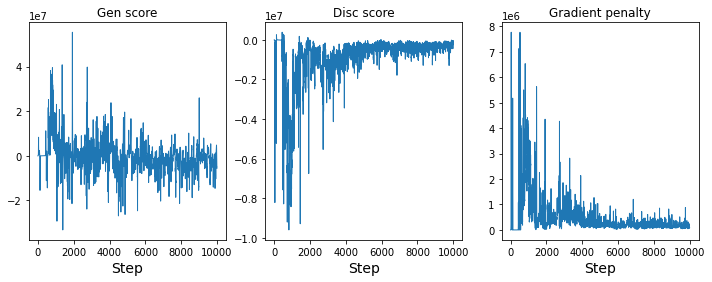

Time taken: 5681.2sec


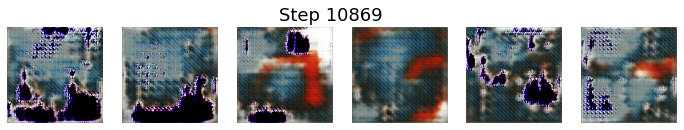

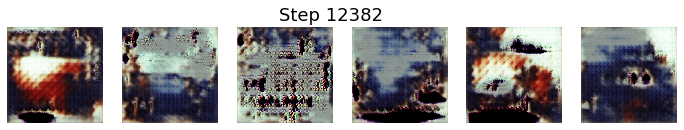

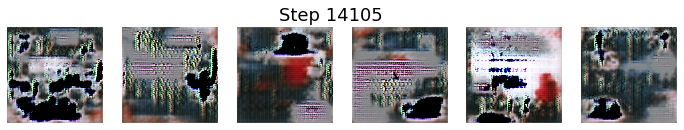

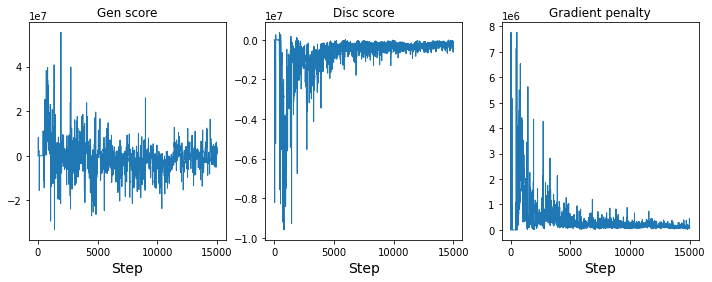

Time taken: 8476.1sec


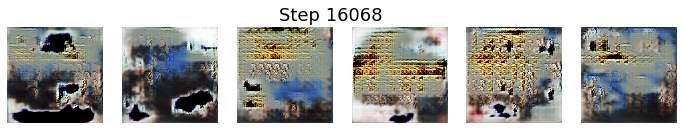

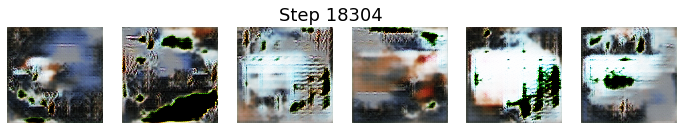

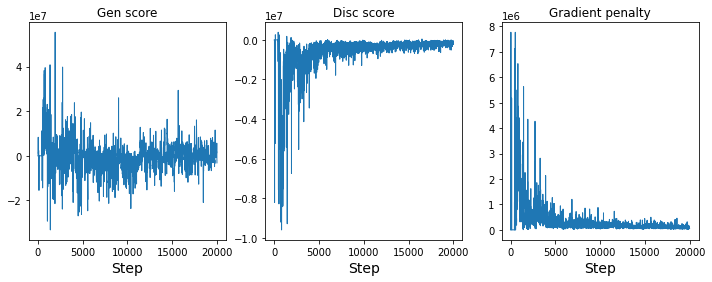

Time taken: 11294.1sec


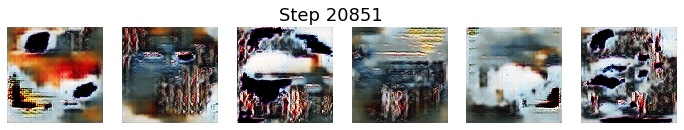

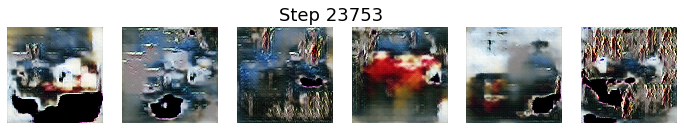

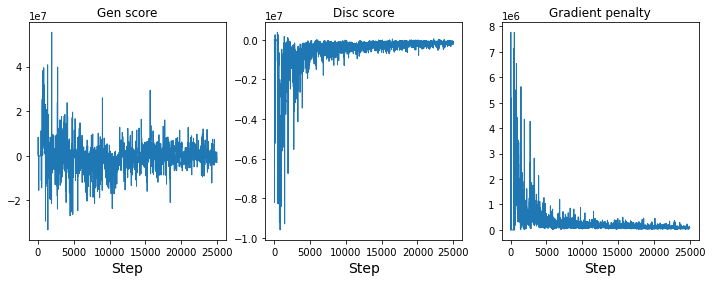

Time taken: 14069.5sec


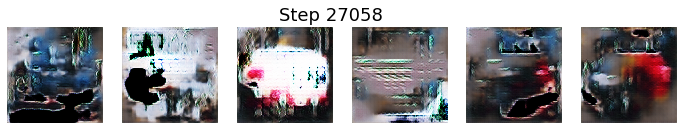

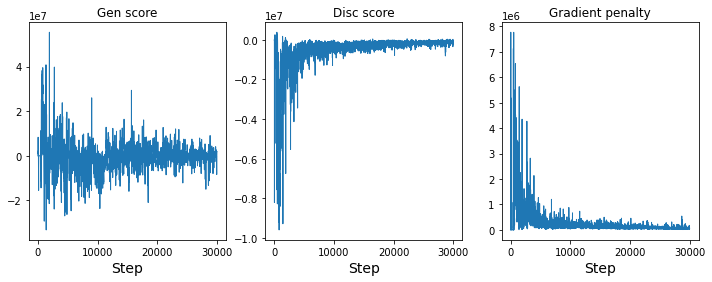

Time taken: 16891.0sec


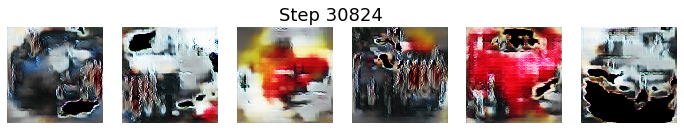

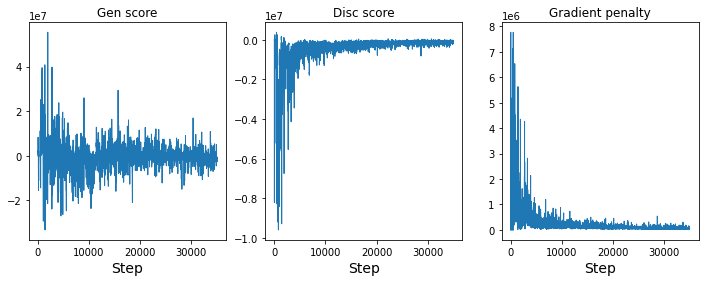

Time taken: 19692.8sec


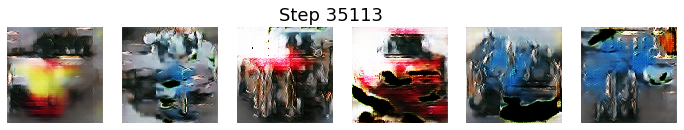

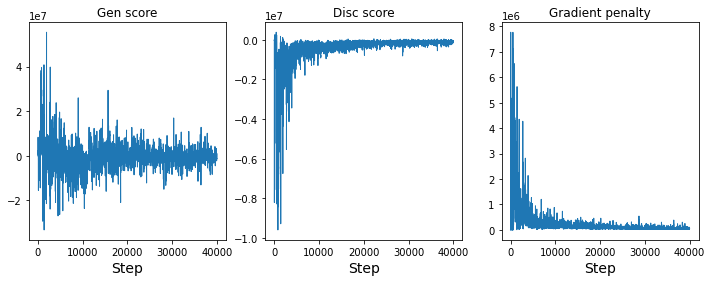

Time taken: 22529.5sec


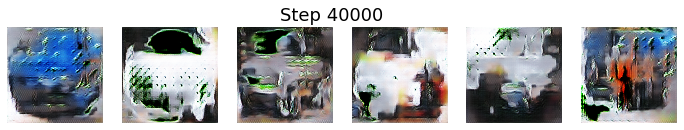

In [55]:
start_time = time.time()
bs = 64
num_steps = 40_000

lr_gen = 3e-4
lr_disc = 3e-4

lambda_p = 1.

opt_gen = tf.keras.optimizers.Adam(lr_gen)
opt_disc = tf.keras.optimizers.Adam(lr_disc)

@tf.function
def training_step(real_images):
  z_vec = tf.random.uniform((bs, zdim), minval=-1., maxval=1., dtype=tf.float32)
  with tf.GradientTape(persistent=True) as tape:
    fake_images = generator(z_vec, training=True)
    fake_scores = discriminator(fake_images, training=True)[0]  # they were grabbing the sigmoided logit, but I think we want the unbounded logit
    real_scores = discriminator(real_images, training=True)[0] 
    loss_generator = -tf.reduce_mean(fake_scores)
    discriminator_correctness = tf.reduce_mean(fake_scores) - tf.reduce_mean(real_scores)

    # All of the below is a 'gradient penalty' which is needed for the particular GAN loss we use above (a Wasserstein GAN, or WGAN, where the scores are unbounded)
    # Basically you want the output score to never change too fast with respect to an input image, so we pick random inputs and random directions by randomly interpolating
    # between a real image and a generated image; then you compute the gradient of the discriminator output with respect to the pixels and enforce that it's close to 1
    epsilon = tf.random.uniform((bs, 1, 1, 1))
    interpolated_images = epsilon * real_images + (1 - epsilon) * fake_images
    logit_score = discriminator(interpolated_images, training=True)[0]
    gradients = tf.reshape(tf.gradients([logit_score], [interpolated_images])[0], [bs, -1])
    slopes = tf.sqrt(tf.reduce_mean(tf.square(gradients), axis=-1))
    gradient_penalty = tf.reduce_mean(tf.square(slopes - 1))
    loss_discriminator = discriminator_correctness + lambda_p * gradient_penalty

  grads_gen = tape.gradient(loss_generator, generator.trainable_variables)
  grads_disc = tape.gradient(loss_discriminator, discriminator.trainable_variables)
  del tape
  opt_gen.apply_gradients(zip(grads_gen, generator.trainable_variables))
  opt_disc.apply_gradients(zip(grads_disc, discriminator.trainable_variables))
  return loss_generator, discriminator_correctness, gradient_penalty 

scores_gen, scores_disc, grad_penalties = [[], [], []]

for step, real_images in enumerate(dset.repeat().shuffle(5_000).batch(bs).take(num_steps+1)):

  score_gen, score_disc, grad_penalty = training_step(real_images)
  
  scores_gen.append(score_gen.numpy())
  scores_disc.append(score_disc.numpy())
  grad_penalties.append(grad_penalty.numpy())
  if step in plot_steps:
    z_vec = tf.random.uniform((bs, zdim), minval=-1., maxval=1., dtype=tf.float32)
    fake_images = generator(z_vec, training=False)
    plt.figure(figsize=(12, 2))
    for plt_ind in range(6):
      plt.subplot(1, 6, plt_ind+1)
      plt.imshow(fake_images[plt_ind])
      plt.axis('off')
    plt.suptitle(f'Step {step}', fontsize=18)
    plt.show()
  if (step+1) % 5_000 == 0:
    plt.figure(figsize=(12, 4))
    plt.subplot(131)
    plt.plot(scores_gen, lw=1)
    plt.title('Gen score')
    plt.xlabel('Step', fontsize=14)

    plt.subplot(132)
    plt.plot(scores_disc, lw=1)
    plt.title('Disc score')
    plt.xlabel('Step', fontsize=14)

    plt.subplot(133)
    plt.plot(grad_penalties, lw=1)
    plt.title('Gradient penalty')
    plt.xlabel('Step', fontsize=14)
    plt.show()
    print(f'Time taken: {time.time()-start_time:.1f}sec')

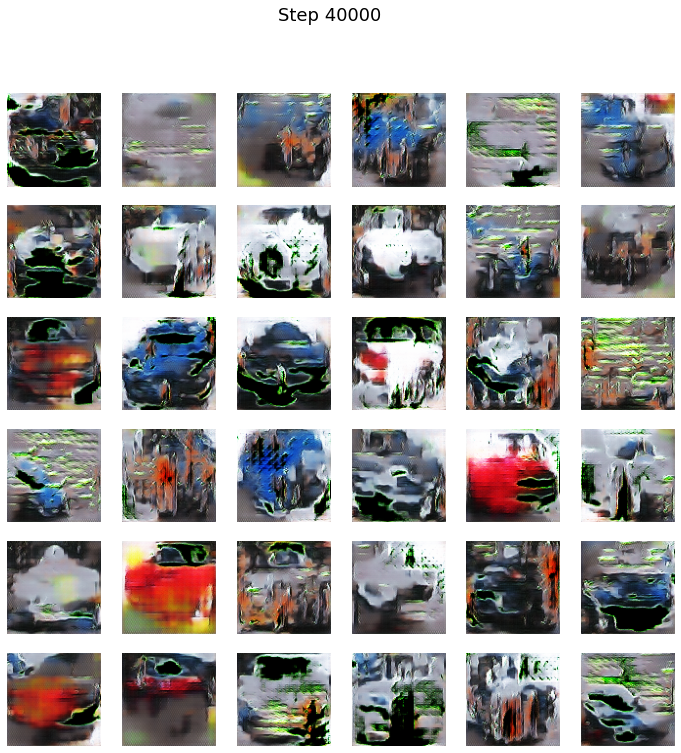

In [56]:
# Looking like some primordial dream world cars!  Let's train some more
z_vec = tf.random.uniform((bs, zdim), minval=-1., maxval=1., dtype=tf.float32)
fake_images = generator(z_vec, training=False)
plt.figure(figsize=(12, 12))
for plt_ind in range(36):
  plt.subplot(6, 6, plt_ind+1)
  plt.imshow(fake_images[plt_ind])
  plt.axis('off')
plt.suptitle(f'Step {step}', fontsize=18)
plt.show()

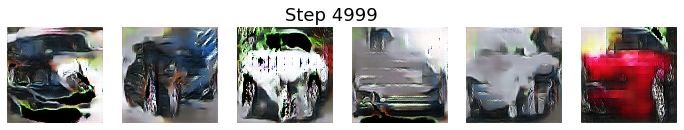

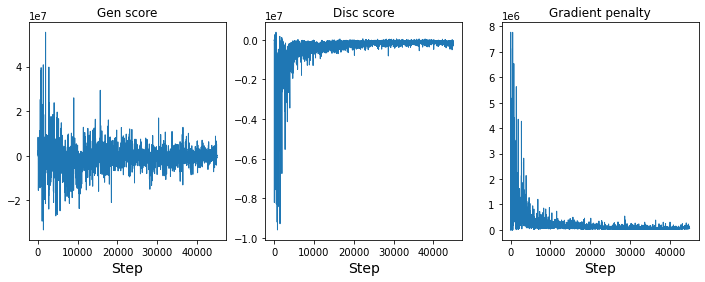

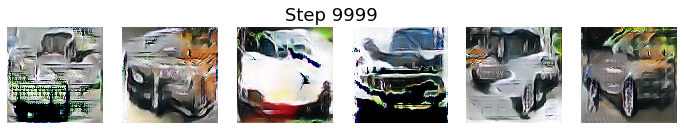

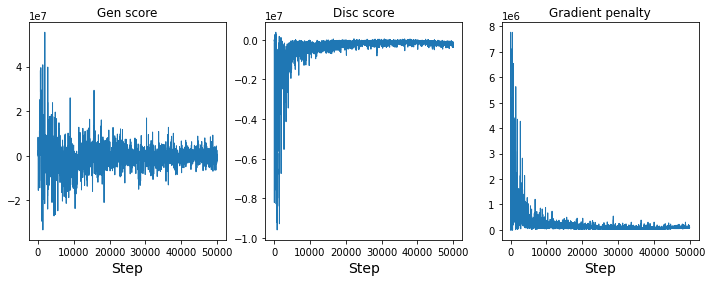

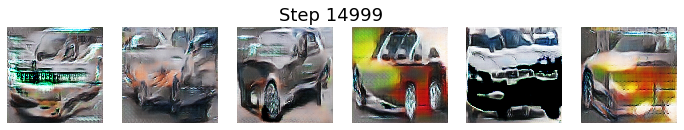

...

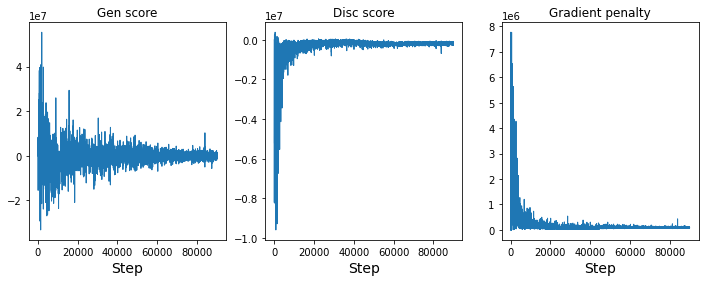

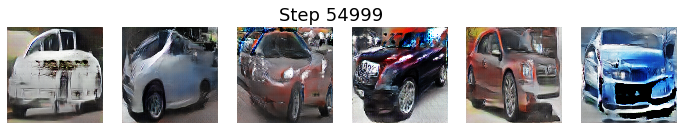

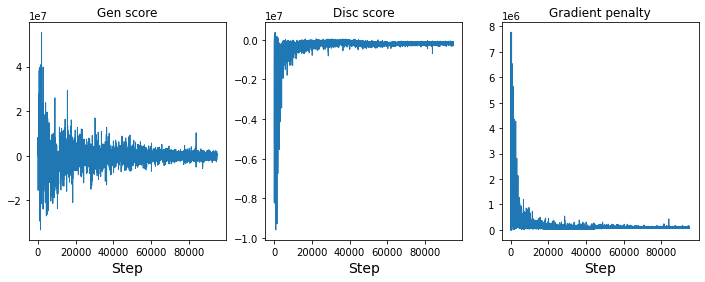

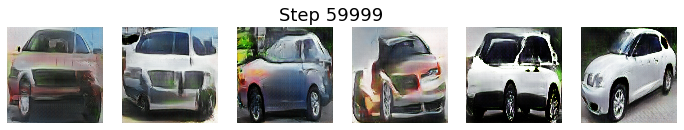

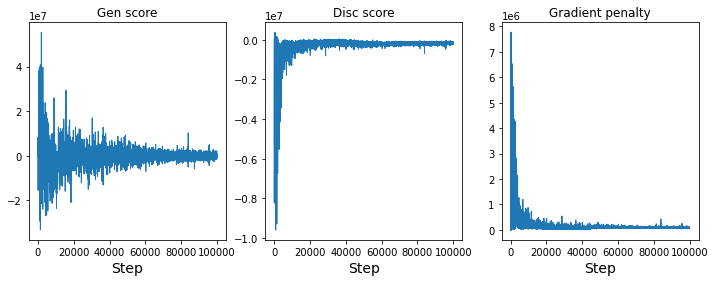

In [57]:
# Ok 40k iterations wasn't enough; let's go for another 60k iters
num_additional_steps = 60_000

for step, real_images in enumerate(dset.repeat().shuffle(5_000).batch(bs).take(num_additional_steps+1)):

  # First generate some fake images
  score_gen, score_disc, grad_penalty = training_step(real_images)
  scores_gen.append(score_gen.numpy())
  scores_disc.append(score_disc.numpy())
  grad_penalties.append(grad_penalty.numpy())
  if (step+1) % 5_000 == 0:
    z_vec = tf.random.uniform((bs, zdim), minval=-1., maxval=1., dtype=tf.float32)
    fake_images = generator(z_vec, training=False)
    plt.figure(figsize=(12, 2))
    for plt_ind in range(6):
      plt.subplot(1, 6, plt_ind+1)
      plt.imshow(fake_images[plt_ind])
      plt.axis('off')
    plt.suptitle(f'Step {step}', fontsize=18)
    plt.show()

    plt.figure(figsize=(12, 4))
    plt.subplot(131)
    plt.plot(scores_gen, lw=1)
    plt.title('Gen score')
    plt.xlabel('Step', fontsize=14)

    plt.subplot(132)
    plt.plot(scores_disc, lw=1)
    plt.title('Disc score')
    plt.xlabel('Step', fontsize=14)

    plt.subplot(133)
    plt.plot(grad_penalties, lw=1)
    plt.title('Gradient penalty')
    plt.xlabel('Step', fontsize=14)
    plt.show()

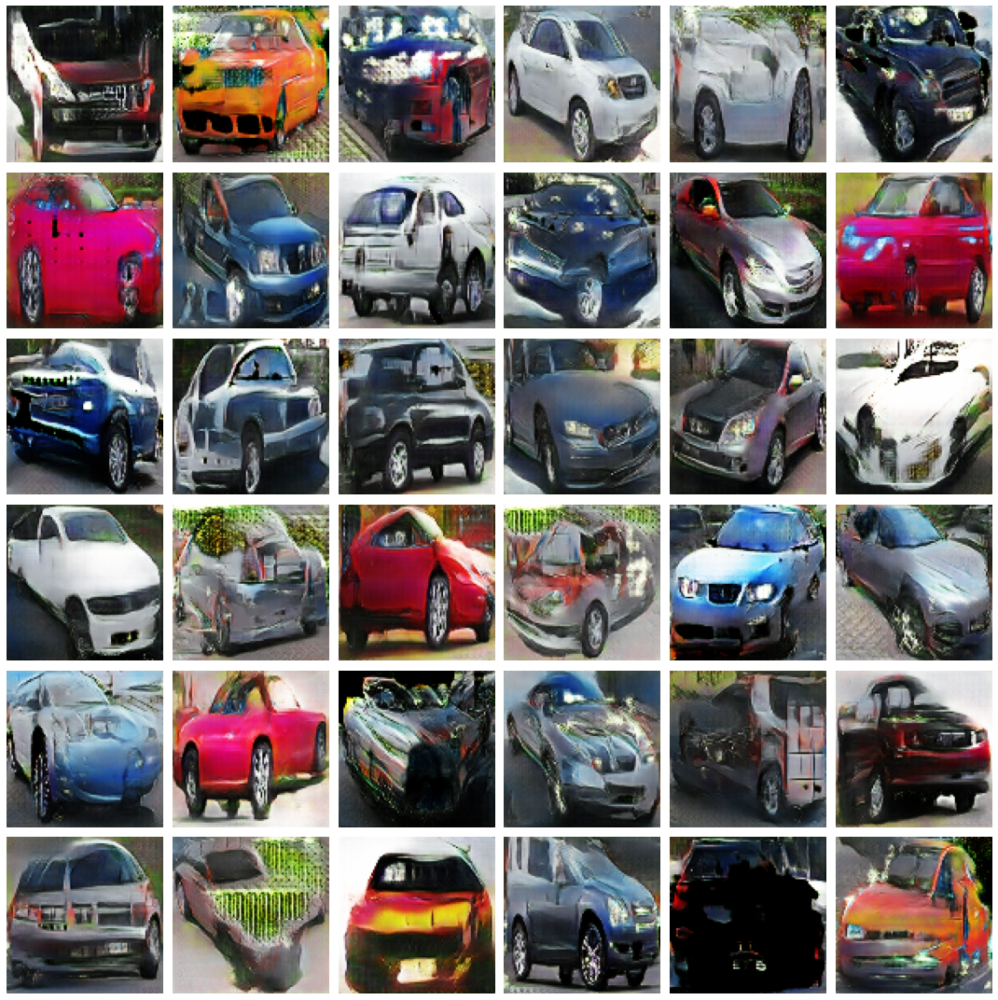

In [76]:
# Now we're talking!  Generating dream cars is as easy as sampling z space and feeding it through the generator
z_vec = tf.random.uniform((bs, zdim), minval=-1., maxval=1., dtype=tf.float32)
fake_images = generator(z_vec, training=False)
plt.figure(figsize=(15, 15))
for plt_ind in range(36):
  plt.subplot(6, 6, plt_ind+1)
  plt.imshow(fake_images[plt_ind])
  plt.axis('off')
plt.tight_layout()
plt.show()

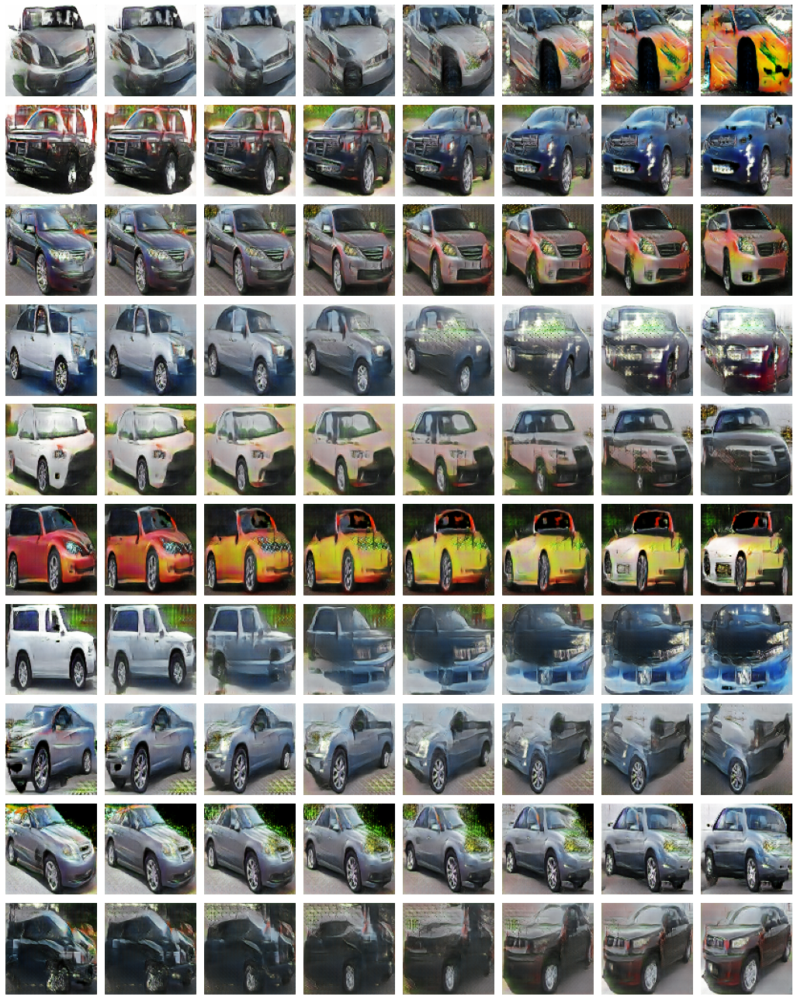

In [74]:
# As with the VAEs from last week, we can interpolate through this latent space and visualize the changing output
# Pick two random points and interpolate between them
num_interpolations = 10
num_pts_per_interpolation = 8
inches_per = 1.8
plt.figure(figsize=(num_pts_per_interpolation*inches_per, num_interpolations*inches_per))
plt_ind = 0
for row in range(num_interpolations):
  z_vec = tf.random.uniform((2, zdim), minval=-1., maxval=1., dtype=tf.float32)
  z_vec = z_vec[:1] + (z_vec[1:] - z_vec[:1]) * np.linspace(0, 1, num_pts_per_interpolation)[:, np.newaxis]
  fake_images = generator(z_vec, training=False)
  for col in range(num_pts_per_interpolation):
    plt.subplot(num_interpolations, num_pts_per_interpolation, plt_ind+1)
    plt.imshow(fake_images[col])
    plt.axis('off')
    plt_ind += 1
plt.tight_layout()
plt.show()

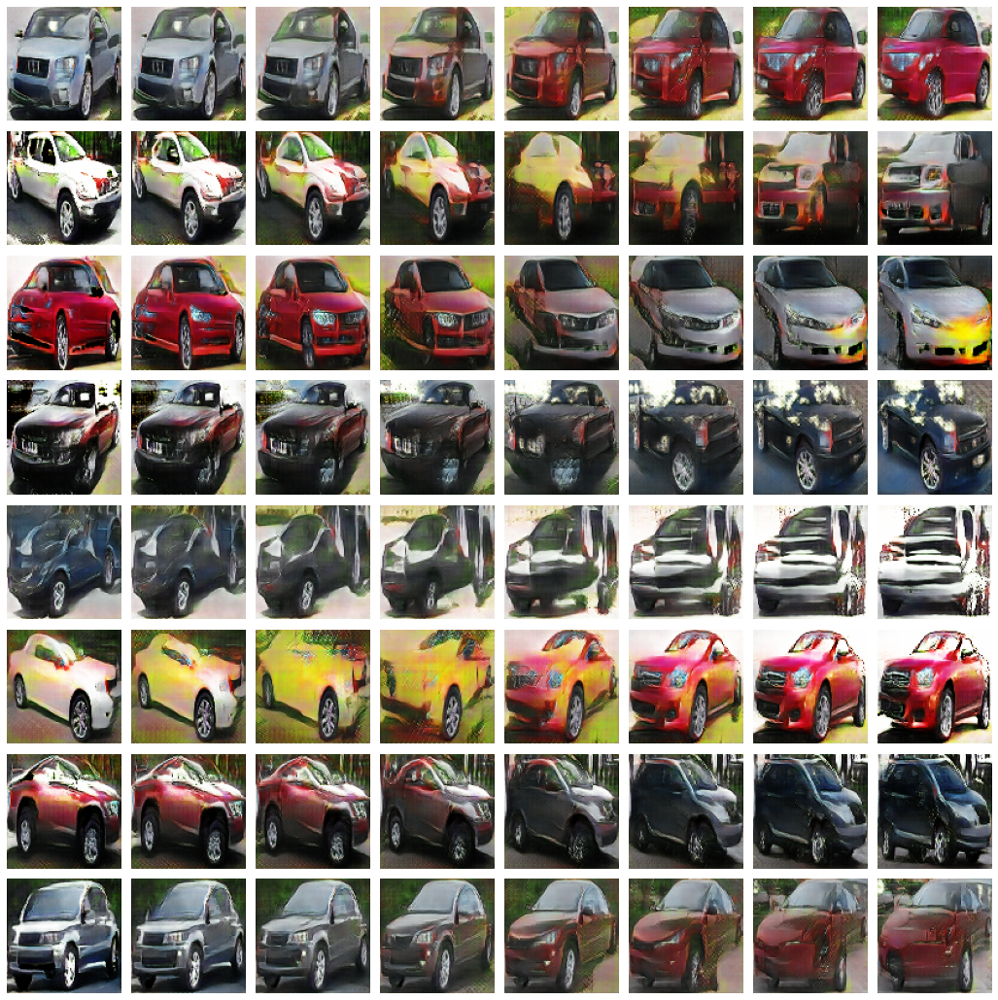

In [209]:
# Ok these are too cool; do some more
num_interpolations = 8
num_pts_per_interpolation = 8
inches_per = 1.8
plt.figure(figsize=(num_pts_per_interpolation*inches_per, num_interpolations*inches_per))
plt_ind = 0
for row in range(num_interpolations):
  z_vec = tf.random.uniform((2, zdim), minval=-1., maxval=1., dtype=tf.float32)
  z_vec = z_vec[:1] + (z_vec[1:] - z_vec[:1]) * np.linspace(0, 1, num_pts_per_interpolation)[:, np.newaxis]
  fake_images = generator(z_vec, training=False)
  for col in range(num_pts_per_interpolation):
    plt.subplot(num_interpolations, num_pts_per_interpolation, plt_ind+1)
    plt.imshow(fake_images[col])
    plt.axis('off')
    plt_ind += 1
plt.tight_layout()
plt.show()